# Cleaning

In [1]:
import pandas as pd
import numpy as np

import missingno as msno
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split 
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.decomposition import TruncatedSVD

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
import datetime
from dateutil.parser import parse
from sklearn.tree import  DecisionTreeClassifier
import plotly.graph_objects as go
import umap
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
import xgboost as xgb
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import GridSearchCV
import ml_metrics
import seaborn as sns
import warnings
from plotly.subplots import make_subplots
from sklearn.metrics import accuracy_score
import plotly.graph_objects as go
warnings.filterwarnings("ignore")



In [2]:
Data=pd.read_csv("../Datos/consolidation_05June2022.csv").drop(columns=["Unnamed: 0"]).fillna("")
Data.head()

,Duracion_Campaña,B,C,lec_B-B,lec_E-E,lec_D-E,lec_C-D,lec_A-A,num_comunicaciones,Length,...,Renta,Recibe_sueldo_en_cuenta,Segmento_consumidor,Meses_antiguedad,Comuna,Ciudad,Estado_civil,Principalidad,Profesion,Target
0,1.0,4.0,5.0,5.0,0.0,0.0,0.0,0.0,22.0,371,...,R1,0,A,Mayor a 10 años,331.0,13.0,D,B,P164,
1,1.0,2.0,9.0,14.0,1.0,1.0,3.0,0.0,21.0,371,...,R9,0,B,Mayor a 10 años,37.0,5.0,D,E,P164,D-E C-D E-E B-B
2,1.0,2.0,2.0,5.0,0.0,0.0,0.0,0.0,20.0,371,...,R9,1,B,Mayor a 10 años,19.0,4.0,B,D,P114,E-E A-A B-B
3,1.0,2.0,5.0,4.0,0.0,0.0,4.0,0.0,8.0,371,...,R10,0,B,Mayor a 10 años,37.0,5.0,B,C,P164,B-B E-E D-E A-A
4,1.0,6.0,6.0,8.0,0.0,1.0,1.0,0.0,15.0,371,...,R4,0,A,Mayor a 10 años,91.0,13.0,D,B,P85,E-E B-B D-E


<AxesSubplot:>

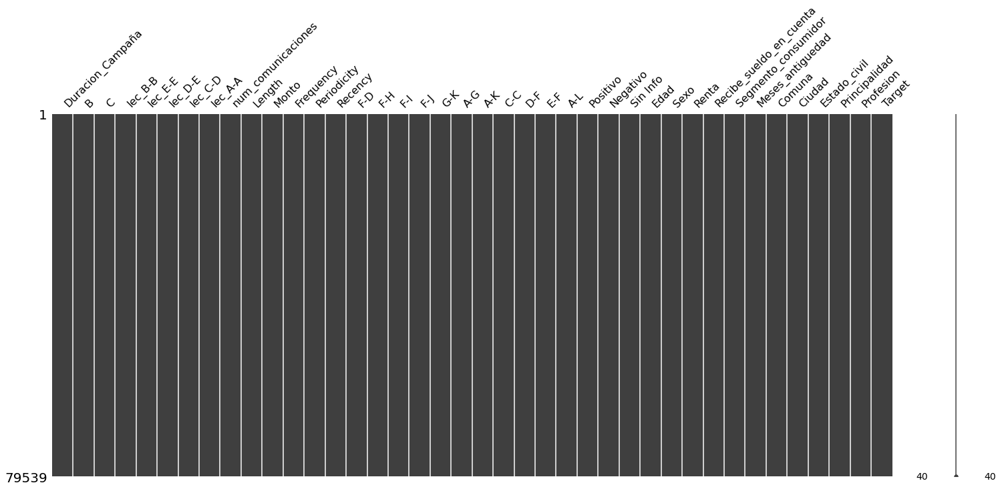

In [3]:
# Missings
msno.matrix(Data)

In [4]:
# datos númericos
numerical=list(Data.select_dtypes(exclude=["category","object"]).columns)
numerical.remove("Sexo")
numerical.remove('Recibe_sueldo_en_cuenta')


# datos categorical
categorical=list(Data.select_dtypes(include=["category","object"]).columns)+['Sexo','Recibe_sueldo_en_cuenta']
categorical

['Edad',
 'Renta',
 'Segmento_consumidor',
 'Meses_antiguedad',
 'Comuna',
 'Ciudad',
 'Estado_civil',
 'Principalidad',
 'Profesion',
 'Target',
 'Sexo',
 'Recibe_sueldo_en_cuenta']

# Clean Target

**Criterio de selección de variables para mejorar la velocidad de la grilla que optimizara MAP**

In [5]:
# Replace valores categoricos por númericos
for i in categorical:
    dic={}
    k=0
    for j in Data[i].unique():
        k=k+1
        dic[j]=k
    Data[i].replace(dic,inplace=True)

In [6]:
# Features - labels

features = Data.drop(columns=["Target"]).copy() 
labels = Data.loc[:,"Target"].copy()

# Generación de conjuntos de train y test
X_train, X_test, y_train, y_test = train_test_split(
    features, labels, test_size=0.33,random_state=50)


In [8]:
# Columns transformer
preprocessing_transformer = ColumnTransformer(
    transformers=[
        ('MinMaxScaler',MinMaxScaler(),
         features.columns),
    ])

pipe = Pipeline(
    [("preprocesamiento", preprocessing_transformer)]
)

In [9]:
# Entrenamiento de pípeline
X_train=pd.DataFrame(pipe.fit_transform(X_train),columns=features.columns)

In [10]:
# Según el aporte de información con el criterio gini de un arbol de decisión
fs = DecisionTreeClassifier(criterion='gini', max_depth=10, random_state=1)
fs.fit(X_train, y_train.astype(int))

DecisionTreeClassifier(max_depth=10, random_state=1)

In [11]:
var_num = 30
table = pd.DataFrame({'Tags': features.columns, 'Value': fs.feature_importances_})
table['Abs_Value'] = table['Value'].abs()
table = table[table['Abs_Value']>0].sort_values(by='Abs_Value', ascending=False, ignore_index=True)
tree_fs = table.loc[:var_num, 'Tags'].to_list()

In [12]:
tree_fs

['E-F',
 'C-C',
 'D-F',
 'A-K',
 'num_comunicaciones',
 'Length',
 'Positivo',
 'Monto',
 'Recency',
 'lec_B-B',
 'B',
 'Comuna',
 'G-K',
 'lec_A-A',
 'Frequency',
 'A-G',
 'F-I',
 'F-J',
 'Renta',
 'Profesion',
 'Periodicity',
 'Principalidad',
 'Duracion_Campaña',
 'Negativo',
 'Edad',
 'F-D',
 'F-H',
 'Sin Info',
 'lec_C-D',
 'Ciudad',
 'A-L']

In [14]:
# Plot
fig = go.Figure([go.Bar(x=table["Tags"], y=table["Abs_Value"])])

fig.update_layout(
    title_text="Importancia de variables",
)

fig.show()

In [15]:
# Selección de variables provisoria para poder iterar de manera más rapida
tags2=['E-F',
 'C-C',
 'D-F',
 'A-K',
 'num_comunicaciones',
 'Length',
 'Positivo',
 'Monto',
 'Recency',
 'lec_B-B',
 'B',
 'Comuna',
 'G-K',
 'lec_A-A',
 'Frequency',
 'A-G',
 'F-I',
 'F-J']
numerical2=list(filter(lambda x:x  in numerical,tags2))
categorical2=list(filter(lambda x:x  in categorical,tags2))

**Distribucion inicial Target**

In [3]:
Data=pd.read_csv("../Datos/consolidation_05June2022.csv").drop(columns=["Unnamed: 0"]).fillna("")

In [17]:
# Visualización
px.histogram(Data, x="Target",title="Distribution Plot Target")

In [18]:
preprocessing_transformer = ColumnTransformer(
    transformers=[('OneHotEncoder', OneHotEncoder(handle_unknown="ignore"), categorical2),
        ('MinMax', MinMaxScaler(),numerical2),
    ])

In [19]:
pipe_naive = Pipeline(
    [
        ("preprocesamiento", preprocessing_transformer), 
     ("clf",MultinomialNB())
    ]
)

In [23]:
pipe_decision_tree = Pipeline(
    [("preprocesamiento", preprocessing_transformer),
     ("clf", DecisionTreeClassifier(random_state=0))]
)


In [20]:
list_map=[]
list_accuracy=[]
num_categorias_target=[]
cut=list(np.arange(5,1000,10))
for i in cut:
    print(i)
    # Generación de conjuntos de train y test
    XYtrain, XYtest = train_test_split(
        Data, test_size=0.33 ) 

    # nombre cols
    XYtrain=pd.DataFrame(XYtrain,columns=Data.columns)
    XYtest=pd.DataFrame(XYtest,columns=Data.columns)

    # Sep target test
    Xtest=XYtest.drop(columns=["Target"]).copy()
    Ytest=XYtest["Target"].copy()

    # Dejamos target con una cantidad mayor a x
    targets_creibles=list(XYtrain["Target"].value_counts()[XYtrain["Target"].value_counts()>i].index)

    # Append categorias
    num_categorias_target.append(len(targets_creibles))###############

    # filtro
    XYtrain=XYtrain[XYtrain["Target"].isin(targets_creibles)]

    
    # Sep target train
    Xtrain=XYtrain.drop(columns=["Target"]).copy()
    Ytrain=XYtrain["Target"].copy()

    
    # ROS
    ros=RandomOverSampler(random_state=0)
    
    # ROS:
    Xtrain, Ytrain=ros.fit_resample(Xtrain,Ytrain)

    # FIT:
    # Train
    pipe_naive.fit(Xtrain, Ytrain)

    # Pred
    Ypred = pipe_naive.predict(Xtest)
    
    # Accuracy
    list_accuracy.append(accuracy_score(Ypred, Ytest))##################
    #MAP
    Ypred_map=pd.Series(Ypred).apply( lambda x: x.split(" "))
    Ytest_map=pd.Series(Ytest).apply( lambda x: x.split(" "))
    list_map.append(ml_metrics.mapk(Ytest_map, Ypred_map, 5))#######################

5
15
25
35
45
55
65
75
85
95
105
115
125
135
145
155
165
175
185
195
205
215
225
235
245
255
265
275
285
295
305
315
325
335
345
355
365
375
385
395
405
415
425
435
445
455
465
475
485
495
505
515
525
535
545
555
565
575
585
595
605
615
625
635
645
655
665
675
685
695
705
715
725
735
745
755
765
775
785
795
805
815
825
835
845
855
865
875
885
895
905
915
925
935
945
955
965
975
985
995


In [35]:
# Visualización

fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=("Métrica MAP", "Métrica Accuracy","Valores únicos target"))
# Create traces

fig.add_trace(go.Scatter(x=cut, y=list_map,
                    mode='lines',
                    name='MAP'),row=1, col=1)
fig.add_trace(go.Scatter(x=cut, y=list_accuracy,
                    mode='lines',
                    name='Accuracy'),row=2, col=1)
fig.add_trace(go.Scatter(x=cut, y=num_categorias_target,
                    mode='lines', name='# Categorias'),row=3, col=1)

fig.update_layout(title_text="Optimización MAP",
                      height=800,
                      width=1000,font=dict(#color="white"
                      ),#template="plotly_dark",
                      legend_tracegroupgap = 90,legend_title="Leyenda")

fig.update_xaxes(title_text="Criterio de Corte",row=3, col=1)
fig.update_yaxes(title_text="MAP", row=1, col=1)
fig.update_yaxes(title_text="Accuracy", row=2, col=1)
fig.update_yaxes(title_text="# Categorias", row=3, col=1)
fig.add_vrect(x0=455, x1=455,opacity=0.25,fillcolor="#0EB9B9")
fig.show()

#### Bajo este criterio, se eliminan las categorias que no contribuyen a maximizar el MAP.


In [26]:
# Dejamos target con una cantidad mayor a 500
targets_creibles=list(Data["Target"].value_counts()[Data["Target"].value_counts()>455].index)
len(targets_creibles)

35

In [27]:
Data=Data[Data["Target"].isin(targets_creibles)]
Data.head()

,Duracion_Campaña,B,C,lec_B-B,lec_E-E,lec_D-E,lec_C-D,lec_A-A,num_comunicaciones,Length,...,Renta,Recibe_sueldo_en_cuenta,Segmento_consumidor,Meses_antiguedad,Comuna,Ciudad,Estado_civil,Principalidad,Profesion,Target
0,1.0,4.0,5.0,5.0,0.0,0.0,0.0,0.0,22.0,371,...,R1,0,A,Mayor a 10 años,331.0,13.0,D,B,P164,
4,1.0,6.0,6.0,8.0,0.0,1.0,1.0,0.0,15.0,371,...,R4,0,A,Mayor a 10 años,91.0,13.0,D,B,P85,E-E B-B D-E
6,1.0,2.0,3.0,1.0,0.0,0.0,1.0,0.0,26.0,371,...,R5,0,A,Mayor a 10 años,34.0,5.0,B,C,P143,D-E A-A
7,1.2,7.0,3.0,5.0,0.0,0.0,2.0,2.0,34.0,371,...,R9,0,A,Mayor a 10 años,331.0,13.0,B,C,P1,E-E
9,1.0,4.0,1.0,1.0,0.0,0.0,0.0,0.0,24.0,371,...,R2,0,B,Mayor a 10 años,37.0,5.0,D,F,P210,D-E


In [28]:
# Visualización
px.histogram(Data, x="Target",title="Distribution Plot Target")

In [29]:
Data.shape

(65030, 40)

# Outliers

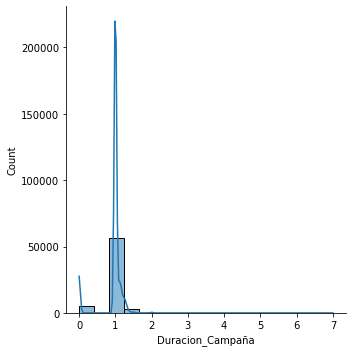

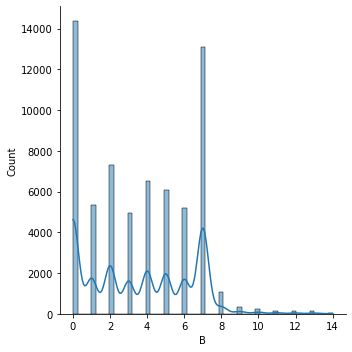

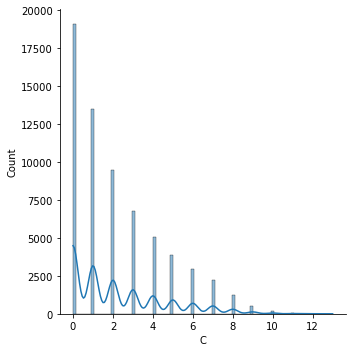

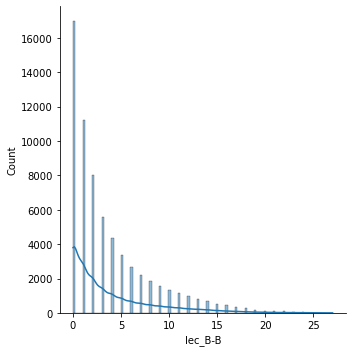

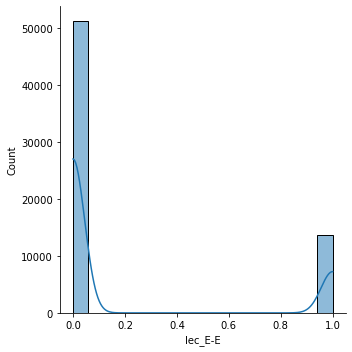

...

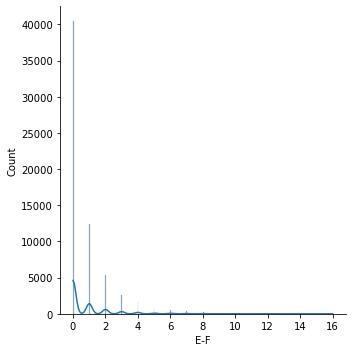

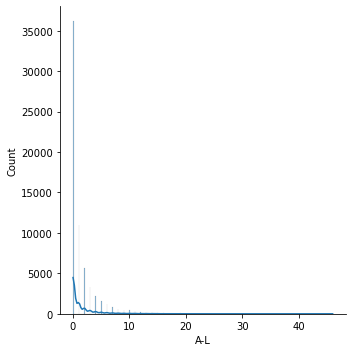

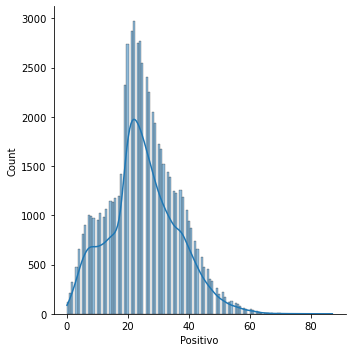

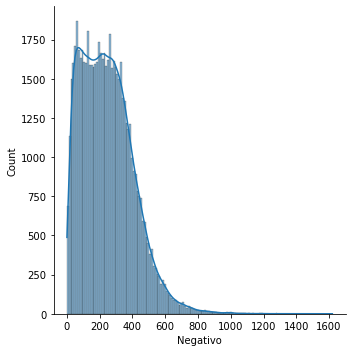

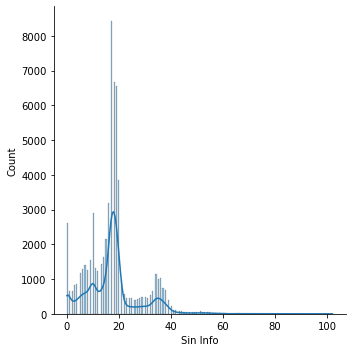

In [30]:
# Numeric
for i in numerical:
    sns.displot(Data, x=i, kde=True)
    plt.show()

In [31]:
# Categorical
for i in categorical:
    Data[i]=Data[i].astype(str)

In [33]:
# Categorical
for i in categorical:
    fig = px.histogram(Data, x=i, marginal="box",title="Distribution Plot "+i,height=800,
                      width=1000)
    fig.show()

#### De momento se mantiene la distribución original de los datos.

In [4]:
# Se guarda raw en csv
Data.to_csv('../Datos/cleaned_'+pd.to_datetime('today').strftime('%d%B%Y')+'.csv', index=True)